In [43]:
import pandas as pd
import numpy as np
from Strategies import *
from StrategyTester import StrategyTester
from tqdm import tqdm
from StrategyOptimizer import StrategyOptimizer
import warnings
warnings.filterwarnings('ignore')

In [44]:
data=pd.read_csv('EURUSD_1m_1_year.csv', parse_dates=['Date'], index_col='Date')

In [45]:
data

,Open,High,Low,Close,vol,spread,pips
Date,,,,,,,
2022-05-02 00:00:00,1.05349,1.05402,1.05348,1.05394,291,0.000100,1.00
2022-05-02 00:01:00,1.05393,1.05401,1.05390,1.05398,203,0.000100,1.00
2022-05-02 00:02:00,1.05399,1.05410,1.05391,1.05404,170,0.000100,1.00
2022-05-02 00:03:00,1.05406,1.05450,1.05406,1.05443,163,0.000100,1.00
2022-05-02 00:04:00,1.05443,1.05448,1.05431,1.05436,106,0.000100,1.00
...,...,...,...,...,...,...,...
2023-04-28 20:54:00,1.10174,1.10174,1.10168,1.10168,19,0.000095,0.95
2023-04-28 20:55:00,1.10168,1.10176,1.10166,1.10172,67,0.000095,0.95
2023-04-28 20:56:00,1.10174,1.10176,1.10166,1.10168,44,0.000095,0.95


In [46]:
tester=StrategyTester(data=data, symbol='EURUSD', strategy_func=rsi_divergence_sl_tp)

In [47]:
tester.test_strategy(freq=15,window_rsi=14, order_rsi=5, rsi_up=70, rsi_down=30)

,buy_and_hold,rsi_divergence_sl_tp_startegy
simple_return,1.04407,1.47802
mean_return,0.04360,0.39503
stddev,0.10782,0.06794
sharpe_ratio,0.40440,5.81458
sortino_ratio,0.57739,8.93424
max_dd,0.11561,0.01910
cagr,0.04457,0.48443
calmar_ratio,0.38549,25.36846
kelly,0.03984,0.74692


In [48]:
tester.plot_results()

In [50]:
tester.plot_trades(start='2022-06-02', end='2022-06-10')

In [12]:
optimizer=StrategyOptimizer(folds=5, test_size=0.3, symbol='EURUSD', data_tester=data,
                            strategy_func=rsi_divergence_sl_tp)

100%|█████████████████████████████████████████| 240/240 [10:00<00:00,  2.50s/it]


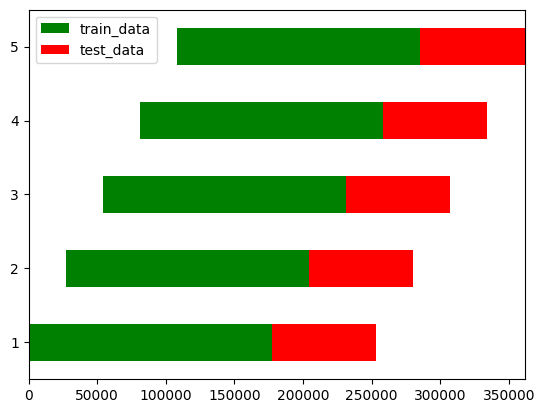

In [15]:
optimizer.test_params(freq=[5,15,30], window_rsi=(10,20,1), order_rsi=(2,10,1), rsi_up=[70], rsi_down=[30])

In [18]:
optimizer.results_overview.sort_values(by='simple_return', ascending=False)

,freq,window_rsi,order_rsi,rsi_up,rsi_down,simple_return,mean_return,stddev,sharpe_ratio,sortino_ratio,max_dd,cagr,calmar_ratio,kelly
7,5,10,9,70,30,1.520458,0.856608,0.056028,15.281852,27.712922,0.007144,1.358010,191.290240,0.879192
23,5,12,9,70,30,1.505340,0.836018,0.061260,13.634378,23.428410,0.011726,1.310544,113.027524,0.845664
15,5,11,9,70,30,1.498504,0.826616,0.058094,14.213298,25.008842,0.007266,1.289196,177.863362,0.864242
31,5,13,9,70,30,1.483200,0.806014,0.064526,12.485784,21.058362,0.011382,1.240824,112.170192,0.825256
39,5,14,9,70,30,1.472078,0.790722,0.065604,12.049166,19.398492,0.011912,1.206528,101.302336,0.808836
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
170,30,11,4,70,30,1.139994,0.267608,0.065360,4.096876,6.063078,0.019982,0.307780,15.522508,0.802658
169,30,11,3,70,30,1.137896,0.263574,0.068520,3.850928,5.666988,0.015568,0.303068,19.523484,0.767620
191,30,13,9,70,30,1.137442,0.263018,0.058076,4.516048,6.772062,0.030470,0.301834,9.907278,0.850598
190,30,13,8,70,30,1.136926,0.262008,0.057772,4.522990,6.767066,0.026020,0.300716,11.556638,0.846694


In [51]:
data_2009=pd.read_csv('EUR_USD_2009_M5.csv', parse_dates=['Date'], index_col='Date')

In [52]:
tester=StrategyTester(data=data_2009, symbol='EURUSD', strategy_func=rsi_divergence_sl_tp)

In [53]:
tester.test_strategy(freq=5,window_rsi=10, order_rsi=9, rsi_up=70, rsi_down=30)

,buy_and_hold,rsi_divergence_sl_tp_startegy
simple_return,1.02368,2.10944
mean_return,0.02347,0.74847
stddev,0.13300,0.05783
sharpe_ratio,0.17648,12.94222
sortino_ratio,0.24789,19.96814
max_dd,0.11294,0.01208
cagr,0.02375,1.11377
calmar_ratio,0.21027,92.16776
kelly,0.05542,0.87533


In [54]:
tester.plot_results()

In [55]:
tester.plot_trades(start='2009-06-02', end='2009-06-10')